# Import Necessary Packages


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Data Loading and visualization

In [2]:
# reading raw csv files
df_data= pd.read_csv('/home/mihret/10AcademyTraining/data/rating.csv')
df_DL= pd.read_csv('/home/mihret/10AcademyTraining/data/domains_location.csv')
# df_data= pd.read_csv('/home/mihret/10AcademyTraining/data/rating.csv', on_bad_lines='skip')
df_t= pd.read_csv('/home/mihret/10AcademyTraining/data/traffic.csv')

# snap of each data to see the data nature

In [3]:
df_data.head()

,article_id,source_id,source_name,author,title,description,url,url_to_image,published_at,content,category,article,title_sentiment
0,81664,NaN,Forbes,"Elizabeth Brownfield, Contributor, \n Elizabet...",superstar chef yannick alléno brings refined f...,Now open in Mayfair at Four Seasons Hotel Lond...,https://www.forbes.com/sites/elizabethbrownfie...,https://imageio.forbes.com/specials-images/ima...,2023-11-01 03:27:21.000000,"Pavyllon London, at Four Seasons Hotel London ...",Monaco,"pavyllon london, at four seasons hotel london ...",Neutral
1,81667,NaN,CNA,NaN,nice claim top spot in ligue 1 with late win a...,Nice moved into provisional first place in the...,https://www.channelnewsasia.com/sport/nice-cla...,https://onecms-res.cloudinary.com/image/upload...,2023-10-27 21:28:48.000000,Nice moved into provisional first place in the...,Monaco,nice moved into provisional first place in the...,Positive
2,81694,time,Time,Christina Larson / AP,amphibians are the world’s most vulnerable spe...,"The world’s frogs, salamanders, newts, and oth...",https://time.com/6320467/amphibians-most-vulne...,https://api.time.com/wp-content/uploads/2023/1...,2023-10-04 17:36:18.000000,"The worlds frogs, salamanders, newts and other...",Madagascar,"the world’s frogs, salamanders, newts and othe...",Negative
3,81695,NaN,Phys.Org,Sara Schmidt,image: rusty red waters in madagascar,Iron-rich sediment colors the red-orange water...,https://phys.org/news/2023-10-image-rusty-red-...,https://scx2.b-cdn.net/gfx/news/2023/image-rus...,2023-10-31 18:04:02.000000,Iron-rich sediment colors the red-orange water...,Madagascar,iron-rich sediment colors the red-orange water...,Neutral
4,81703,NaN,Digital Trends,Jason Struss,everything leaving max (formerly hbo max) in n...,From Gangs of London to Fear the Walking Dead ...,https://www.digitaltrends.com/movies/everythin...,https://www.digitaltrends.com/wp-content/uploa...,2023-10-23 23:09:18.000000,"Everything ends. No, I’m not having an existen...",Madagascar,"everything ends. no, i’m not having an existen...",Neutral


In [30]:
pd.options.display.max_rows= 10
df_DL.head

<bound method NDFrame.head of       SourceCommonName location    Country
0           00221.info       SG    Senegal
1            01net.com       FR     France
2             01net.it       IT      Italy
3          0223.com.ar       AR  Argentina
4         022china.com       CH      China
...                ...      ...        ...
37797      zz.diena.lv       LG     Latvia
37798      zz.fjnet.cn       CH      China
37799        zz.mnw.cn       CH      China
37800           zz7.it       IT      Italy
37801    zznews.gov.cn       CH      China

[37802 rows x 3 columns]>

In [ ]:
df_t.tail

In [59]:
# Data Visualization
df_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58356 entries, 0 to 58355
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   article_id       58356 non-null  int64 
 1   source_id        17771 non-null  object
 2   source_name      58356 non-null  object
 3   author           56193 non-null  object
 4   title            58356 non-null  object
 5   description      58346 non-null  object
 6   url              58356 non-null  object
 7   url_to_image     54905 non-null  object
 8   published_at     58356 non-null  object
 9   content          58356 non-null  object
 10  category         58335 non-null  object
 11  article          58356 non-null  object
 12  title_sentiment  58356 non-null  object
 13  title_length     58356 non-null  int64 
 14  content_length   58356 non-null  int64 
dtypes: int64(3), object(12)
memory usage: 6.7+ MB


In [7]:
#  null values are present in column source_id, author, description(1 value),  url_to_image and category
df_data.isnull().sum()

article_id             0
source_id          40585
source_name            0
author              2163
title                  0
description           10
url                    0
url_to_image        3451
published_at           0
content                0
category              21
article                0
title_sentiment        0
dtype: int64

In [8]:
# Exploring the category column which is to be used for the search query
df_data['category'].unique()

array(['Monaco', 'Madagascar', 'Mexico', 'Maldives', 'Mali', 'Barbados',
       'Nicaragua', 'Congo, The Democratic Republic of the',
       'North Macedonia', 'Malta', 'Poland', 'Myanmar',
       'Russian Federation', 'Mongolia', 'Montenegro', 'Malaysia',
       'Romania', 'Mozambique', 'Montserrat', 'South Sudan', 'News',
       'Israel', 'Mauritania', 'Mauritius', 'Netherlands', 'Martinique',
       'Malawi', 'Germany', 'Niger', 'Namibia', 'Nigeria', 'Georgia',
       'Nepal', 'Facebook', 'Norway', 'COVID', 'Peru', 'Travel',
       'History', 'Papua New Guinea', 'New Zealand', 'Sports', 'Oman',
       'Pakistan', 'Panama', 'Love', 'America', 'Philippines', 'Palau',
       'Politics', 'Armenia', 'Food', 'Sudan', 'Puerto Rico', 'Weather',
       'Real estate', 'Cars', 'Senegal', 'Singapore', 'Stock', 'Ghana',
       'TikTok', 'Photography', 'Kazakhstan', 'Games', 'Climate', 'Space',
       'Somalia', 'Tonga', 'Architecture', 'Art', 'Africa',
       'Relationships', 'Qatar', 'world', '

In [9]:
pd.options.display.max_rows= 10
# pd.set_option("display.min_rows", None)
df_data['category'].value_counts()

Stock          3687
Canada         2066
Health         2046
Real estate    2030
Technology     1993
               ... 
Burundi           3
Andorra           3
Honduras          3
Réunion           2
Martinique        2
Name: category, Length: 256, dtype: int64

In [10]:
# Exploring Text Columns

df_data['title_length']=df_data['title'].apply(lambda x: len(str(x)))
df_data['content_length']=df_data['content'].apply(lambda x: len(str(x)))

__Univariate Data Analysis__

In [11]:
# Perform univariate analysis on the text columns
# number of character of the article's title
df_data['title_length'].describe()

count    58356.000000
mean        76.767033
std         26.009651
min         12.000000
25%         60.000000
50%         73.000000
75%         89.000000
max        326.000000
Name: title_length, dtype: float64

In [12]:
# number of character of the article's content
df_data['content_length'].describe()

count    58356.000000
mean       207.838920
std         28.566682
min         25.000000
25%        213.000000
50%        214.000000
75%        214.000000
max        216.000000
Name: content_length, dtype: float64

In [13]:
df_data['title_sentiment'].describe()

count       58356
unique          3
top       Neutral
freq        42926
Name: title_sentiment, dtype: object

In [14]:
df_data['title_sentiment'].value_counts()

Neutral     42926
Negative     9133
Positive     6297
Name: title_sentiment, dtype: int64

__Bivariate visualizations__

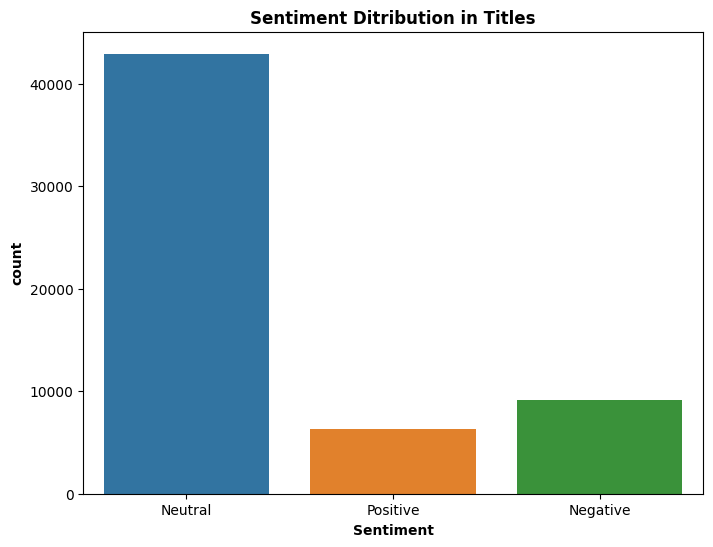

In [63]:
# Visualizing title sentiment distribution over articles
plt.figure(figsize=(8,6))
sns.countplot(data=df_data,x='title_sentiment')
plt.title('Sentiment Ditribution in Titles', fontweight='bold')
plt.xlabel('Sentiment', fontweight='bold')
plt.ylabel('count', fontweight='bold')
plt.show()

plt.style.use('default')

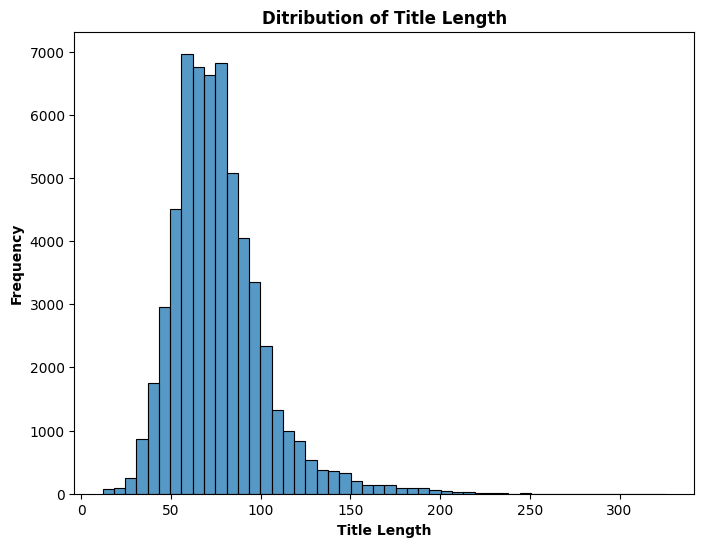

In [66]:
# Visualizing title length distribution using a histogram
plt.figure(figsize=(8,6))
sns.histplot(data=df_data,x='title_length', bins=50) #Set the entire range of values into a series of 50 intervals
plt.title('Ditribution of Title Length', fontweight='bold')
plt.xlabel('Title Length', fontweight='bold')
plt.ylabel('Frequency', fontweight='bold')
plt.show()

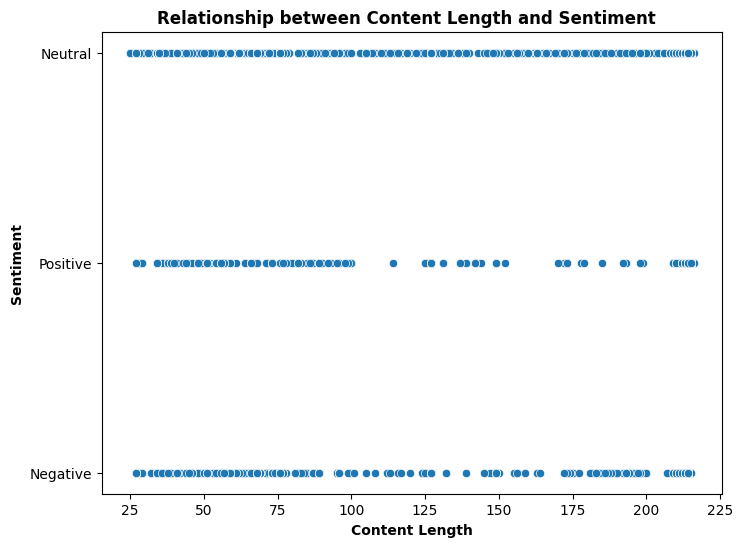

In [67]:
# Relationship between article content length versus sentiment using a scatter plot
    # As content length grows,  what is the distibution of each sentiment? 
plt.figure(figsize=(8,6))
sns.scatterplot(data=df_data,x='content_length', y='title_sentiment') #Set the entire range of values into a series of 50 intervals
plt.title('Relationship between Content Length and Sentiment  ', fontweight='bold')
plt.xlabel('Content Length', fontweight='bold')
plt.ylabel('Sentiment', fontweight='bold')
plt.show()

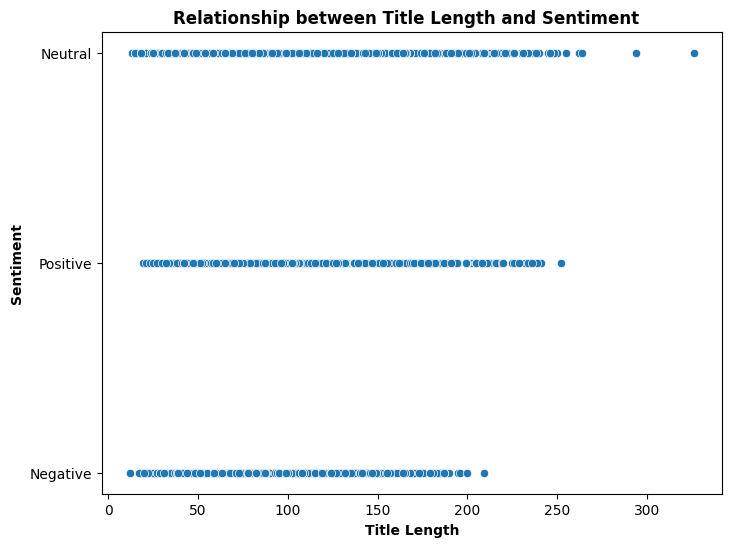

In [70]:
# Relationship between article title length versus sentiment using a scatter plot
    # As title length grows,  what is the distibution of each sentiment? 
plt.figure(figsize=(8,6))
sns.scatterplot(data=df_data,x='title_length', y='title_sentiment') #Set the entire range of values into a series of 50 intervals
plt.title('Relationship between Title Length and Sentiment  ', fontweight='bold')
plt.xlabel('Title Length', fontweight='bold')
plt.ylabel('Sentiment', fontweight='bold')
plt.show()

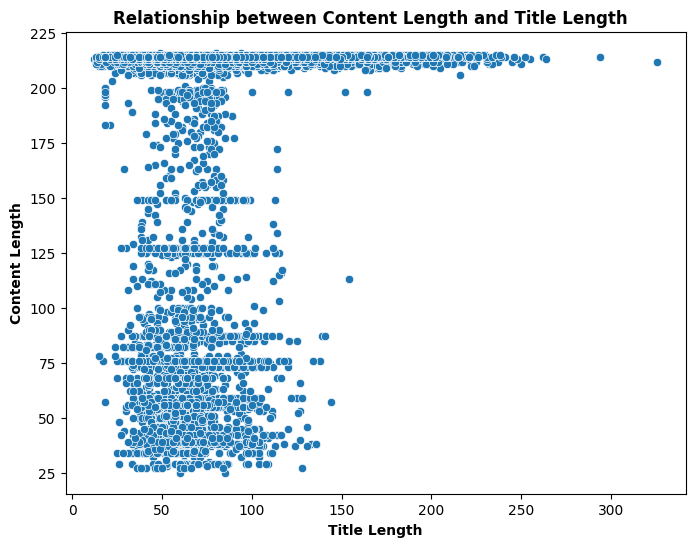

In [68]:
# Relationship between article content length versus title_length using a scatter plot 
    # As title length grows, what is its implication on the content length? 
plt.figure(figsize=(8,6))
sns.scatterplot(data=df_data,x='title_length', y='content_length') #Set the entire range of values into a series of 50 intervals
plt.title('Relationship between Content Length and Title Length  ', fontweight='bold')
plt.xlabel('Title Length', fontweight='bold')
plt.ylabel('Content Length', fontweight='bold')
plt.show()

In [64]:
# Data Cleansing

# Fill nan values of a column 

# EDA Analysis